In [206]:
import os
import sys
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.font_manager
import seaborn as sns
import anndata
import scanpy as sc
import re
import decoupler as dc
import sc_toolbox
import random
import seaborn.objects as so
import scvelo as scv
import cellrank as cr
import warnings
warnings.filterwarnings('ignore')

In [2]:
data_dir = "/well/immune-rep/users/vbw431/Projects/Peppa/data/"
newdata_dir = "/well/immune-rep/users/vbw431/Projects/Peppa/new_analysis/data/"
plot_dir = "/well/immune-rep/users/vbw431/Projects/Peppa/new_out/final_plots/"

sys.path = sys.path + ["/well/immune-rep/users/vbw431/python_utils/"]

In [3]:
import rpy2.rinterface_lib.callbacks
import anndata2ri
import logging
import rpy2.robjects.lib.ggplot2 as gp
from rpy2.robjects import pandas2ri
from rpy2.robjects import r
from rpy2.ipython.ggplot import image_png

#sc.settings.verbosity = 0
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

pandas2ri.activate()
anndata2ri.activate()
%load_ext rpy2.ipython

In [4]:
%%R

.libPaths(c(paste0("/well/immune-rep/users/vbw431/python/scvi_new_ivy/r_modules"), .libPaths()))

library(tidyverse)
library(parallel)
library(Seurat)
library(velocyto.R)
library(SeuratWrappers)

cur.dir = "/well/immune-rep/users/vbw431/Projects/Peppa/data/DIMITRA_FASTQ/"
work.dir = "/well/immune-rep/users/vbw431/Projects/Peppa/"
out.dir = "/well/immune-rep/users/vbw431/Projects/Peppa/out/"
references = "/well/immune-rep/users/vbw431/reference/reference/refdata-gex-GRCh38-2020-A/"
com.out = "/well/immune-rep/users/vbw431/Projects/Peppa/reference_combat/"

##plotting
library(ggplot2); theme_set(theme_bw(base_size = 18)+
                              theme(strip.text = element_text(colour = 'black', face="bold",size=12), 
                                    panel.grid.major = element_blank(), 
                                    panel.grid.minor = element_blank(),
                                    panel.border = element_rect(size = 0.7),
                                    axis.ticks.length=unit(.10, "cm"),
                                    axis.ticks = element_line(size=0.7),
                                    strip.background = element_blank()))




    an issue that caused a segfault when used with rpy2:
    https://github.com/rstudio/reticulate/pull/1188
    Make sure that you use a version of that package that includes
    the fix.
    

In [5]:
%%R
peppa_dirs <- list.files(work.dir,pattern = ".loom$", recursive = TRUE, full.names = TRUE)
peppa_dirs

 [1] "/well/immune-rep/users/vbw431/Projects/Peppa//gex/HBV_C_GEX-AK19400-SCI5E013/velocyto/HBV_C_GEX-AK19400-SCI5E013.loom"                                  
 [2] "/well/immune-rep/users/vbw431/Projects/Peppa//gex/HBV_Tre_GEX_1-AK22875-SCI5E004_HJNCFDSX2/velocyto/HBV_Tre_GEX_1-AK22875-SCI5E004_HJNCFDSX2.loom"      
 [3] "/well/immune-rep/users/vbw431/Projects/Peppa//gex/HBV_Tre_GEX_2-AK26135-SCI5E016_HJNCFDSX2/velocyto/HBV_Tre_GEX_2-AK26135-SCI5E016_HJNCFDSX2.loom"      
 [4] "/well/immune-rep/users/vbw431/Projects/Peppa//gex/HBV_Tre_GEX_3-AK24949-SCI5E028_HJNCFDSX2/velocyto/HBV_Tre_GEX_3-AK24949-SCI5E028_HJNCFDSX2.loom"      
 [5] "/well/immune-rep/users/vbw431/Projects/Peppa//gex/HBV_X2_GEX-AK1499-SCI5E037/velocyto/HBV_X2_GEX-AK1499-SCI5E037.loom"                                  
 [6] "/well/immune-rep/users/vbw431/Projects/Peppa//gex/HH_Tre_GEX_4-AK26855-SCI5E040_HJNCFDSX2/velocyto/HH_Tre_GEX_4-AK26855-SCI5E040_HJNCFDSX2.loom"        
 [7] "/well/immune-rep/users/vbw431/Projects/P

In [6]:
%%R
peppa_path <- gsub("/[^/]*$", "", peppa_dirs)
peppa_samples <- gsub(".*velocyto/","", peppa_dirs)
peppa_samples <- gsub("/.*","", peppa_samples)
peppa_samples

peppa_10xid <- gsub(".*velocyto/","", peppa_dirs)
peppa_10xid <- gsub("/.*","", peppa_10xid)
peppa_10xid <- gsub("_[^_]*$","", peppa_10xid)
peppa_10xid <- gsub("\\-.*","", peppa_10xid)
peppa_10xid <- gsub("_GEX","", peppa_10xid)

peppa_10xid

 [1] "HBV_C"        "HBV_Tre_1"    "HBV_Tre_2"    "HBV_Tre_3"    "HBV_X2"      
 [6] "HH_Tre_4"     "HIVHBV_C"     "HIVHBV_Tre_5" "HIVHBV_X2"    "Healthy"     
[11] "PBMC"        


In [7]:
%%R -o peppa_db
peppa_db<- data.frame(sample=peppa_10xid, dir = as.character(peppa_dirs))
peppa_db

peppa_db <- peppa_db %>%
  filter(sample != "PBMC")
peppa_db

         sample
1         HBV_C
2     HBV_Tre_1
3     HBV_Tre_2
4     HBV_Tre_3
5        HBV_X2
6      HH_Tre_4
7      HIVHBV_C
8  HIVHBV_Tre_5
9     HIVHBV_X2
10      Healthy
                                                                                                                                                       dir
1                                    /well/immune-rep/users/vbw431/Projects/Peppa//gex/HBV_C_GEX-AK19400-SCI5E013/velocyto/HBV_C_GEX-AK19400-SCI5E013.loom
2        /well/immune-rep/users/vbw431/Projects/Peppa//gex/HBV_Tre_GEX_1-AK22875-SCI5E004_HJNCFDSX2/velocyto/HBV_Tre_GEX_1-AK22875-SCI5E004_HJNCFDSX2.loom
3        /well/immune-rep/users/vbw431/Projects/Peppa//gex/HBV_Tre_GEX_2-AK26135-SCI5E016_HJNCFDSX2/velocyto/HBV_Tre_GEX_2-AK26135-SCI5E016_HJNCFDSX2.loom
4        /well/immune-rep/users/vbw431/Projects/Peppa//gex/HBV_Tre_GEX_3-AK24949-SCI5E028_HJNCFDSX2/velocyto/HBV_Tre_GEX_3-AK24949-SCI5E028_HJNCFDSX2.loom
5                                    /well/immune

In [8]:
peppa_db


,sample,dir
1,HBV_C,/well/immune-rep/users/vbw431/Projects/Peppa//...
2,HBV_Tre_1,/well/immune-rep/users/vbw431/Projects/Peppa//...
3,HBV_Tre_2,/well/immune-rep/users/vbw431/Projects/Peppa//...
4,HBV_Tre_3,/well/immune-rep/users/vbw431/Projects/Peppa//...
5,HBV_X2,/well/immune-rep/users/vbw431/Projects/Peppa//...
6,HH_Tre_4,/well/immune-rep/users/vbw431/Projects/Peppa//...
7,HIVHBV_C,/well/immune-rep/users/vbw431/Projects/Peppa//...
8,HIVHBV_Tre_5,/well/immune-rep/users/vbw431/Projects/Peppa//...
9,HIVHBV_X2,/well/immune-rep/users/vbw431/Projects/Peppa//...
10,Healthy,/well/immune-rep/users/vbw431/Projects/Peppa//...


In [9]:
##load data 
ladata_list = []
for file in peppa_db.dir:
        ladata_list.append(scv.read(file, cache=True)) 



/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/gpfs2/w

In [10]:
batches = peppa_db[["sample"]].values
batch_list = []

for i in np.arange(10):
    value = set(batches[i].astype(str))
    batch_list.extend(value)

batch_list

['HBV_C',
 'HBV_Tre_1',
 'HBV_Tre_2',
 'HBV_Tre_3',
 'HBV_X2',
 'HH_Tre_4',
 'HIVHBV_C',
 'HIVHBV_Tre_5',
 'HIVHBV_X2',
 'Healthy']

In [11]:
import re

for i in np.arange(10):
    list1 = [re.sub(".*:", "",x) for x in ladata_list[i].obs_names]
    list2 = [re.sub("x", "-1-" +"".join(map(str, batches[i])),x) for x in list1]
    ladata_list[i].obs_names = list2
    


In [12]:
ladata_list[3].obs_names

Index(['AAACCTGGTTAAAGTG-1-HBV_Tre_3', 'AAACCTGAGTTACGGG-1-HBV_Tre_3',
       'AAACCTGAGAAACCTA-1-HBV_Tre_3', 'AAACGGGCAACTGCTA-1-HBV_Tre_3',
       'AAACCTGAGACTTTCG-1-HBV_Tre_3', 'AAACCTGCAACAACCT-1-HBV_Tre_3',
       'AAACCTGCATTCTTAC-1-HBV_Tre_3', 'AAACCTGAGGGTCGAT-1-HBV_Tre_3',
       'AAACCTGGTCTTCGTC-1-HBV_Tre_3', 'AAACCTGAGAAGAAGC-1-HBV_Tre_3',
       ...
       'TTTGTCACACATAACC-1-HBV_Tre_3', 'TTTGTCACAGTCACTA-1-HBV_Tre_3',
       'TTTGTCACATGGTCAT-1-HBV_Tre_3', 'TTTGTCATCTGGAGCC-1-HBV_Tre_3',
       'TTTGTCAGTATAATGG-1-HBV_Tre_3', 'TTTGTCACAGATCTGT-1-HBV_Tre_3',
       'TTTGTCACAGATGGGT-1-HBV_Tre_3', 'TTTGTCAGTACGACCC-1-HBV_Tre_3',
       'TTTGTCAGTTCCACGG-1-HBV_Tre_3', 'TTTGTCAGTGCAACTT-1-HBV_Tre_3'],
      dtype='object', length=33960)

In [13]:
#ladata_full = ladata_list[0].concatenate(ladata_list[1:9])

In [14]:
adata = sc.read_h5ad("/well/immune-rep/users/vbw431/Projects/Peppa/out/peppa_azi_combat.h5ad")
##load data
labels = ["NK", "CD8", "CD4", "Bcells", "Myeloid_Plt"]
cluster_list = {}
scvi_list = {}
umap_list = {}
for i in [0,1,2,3,4]:
    print("reading in " + labels[i])
    cluster_list[labels[i]] = pd.read_csv(os.path.join(newdata_dir + labels[i] +"_clustering_final/", f"Peppa_{labels[i]}_cluster_assignment.csv"), index_col =0)
    scvi_list[labels[i]] = pd.read_csv(os.path.join(newdata_dir + labels[i] +"_embeddings/", f"Peppa_{labels[i]}_scvi.csv"), index_col =0)
    umap_list[labels[i]] = pd.read_csv(os.path.join(newdata_dir + labels[i] +"_embeddings/", f"Peppa_{labels[i]}_umap.csv"), index_col =0)



reading in NK
reading in CD8
reading in CD4
reading in Bcells
reading in Myeloid_Plt


In [15]:
adata_list = {}

for i in [0,1,2,3, 4]:
    adata_list[labels[i]] = adata[cluster_list[labels[i]].index].copy()
    adata_list[labels[i]].obsm["X_scVI"] = scvi_list[labels[i]].loc[adata_list[labels[i]].obs_names].values
    adata_list[labels[i]].obsm["X_umap"] = umap_list[labels[i]].loc[adata_list[labels[i]].obs_names].values
    adata_list[labels[i]].obs = adata_list[labels[i]].obs.merge(cluster_list[labels[i]], left_index=True, right_index=True, how="inner")
    adata_list[labels[i]].layers['counts'] = adata_list[labels[i]].X.copy()
    sc.pp.normalize_total(adata_list[labels[i]], target_sum=1e4)
    sc.pp.log1p(adata_list[labels[i]])
    adata_list[labels[i]].layers['normalized'] = adata_list[labels[i]].X.copy()
    

In [16]:
##update meta_data with new clinical
clin_meta = pd.read_csv(newdata_dir + "index_demo.csv", index_col = 0)
clin_meta = clin_meta[["disease_group", 
                       "bio_replicate", 
                       "study_disease", 
                       "scanpy_index", 
                       "study_ID", 
                       "Treatment_status",
                      "Ethnicity",
                      "Sex",
                      "Age",
                      "HBV_serostatus",
                      "HBV_sAg_titre",
                      "HBV_DNA_VL"]]
clin_meta


,disease_group,bio_replicate,study_disease,scanpy_index,study_ID,Treatment_status,Ethnicity,Sex,Age,HBV_serostatus,HBV_sAg_titre,HBV_DNA_VL
1.0,HBV-Rx,patient_12,HBV,PBMC_NA,AM64.3,On_treatment,White_caucasian,M,55.0,sAg+:eAg:eAb+,307.000000,0.0
2.0,HBV-Rx,patient_11,HBV,HBV_C_Hashtag.1,CB75.3,On_treatment,BAME,M,44.0,sAg+:eAg-:eAb+,279.000000,22.0
3.0,CTRL-Prep,control_1,CTRL,HBV_C_Hashtag.2,J2067,On_PrEP,White_caucasian,M,46.0,Not_available,NaN,NaN
4.0,HBV_HIV-Rx,patient_10,HBV_HIV,HIVHBV_C_Hashtag.1,RFH-HB004,On_treatment,BAME,M,44.0,sAg+:eAg-:eAb+,208.000000,0.0
5.0,CTRL-Prep,control_1,CTRL,HIVHBV_C_Hashtag.2,J2067,On_PrEP,White_caucasian,M,46.0,Not_available,NaN,NaN
6.0,HBV-Pre,patient_1,HBV,HBV_Tre_1_Hashtag.1,1391,Pre_treatment,White_caucasian,F,55.0,sAg+:eAg-:eAb+,2479.000000,3917.0
7.0,HBV-Rx,patient_1,HBV,HBV_Tre_1_Hashtag.2,1522,On_treatment,White_caucasian,F,56.0,sAg+:eAg-:eAb+,2544.000000,20.0
8.0,HBV-Pre,patient_2,HBV,HBV_Tre_2_Hashtag.1,1380,Pre_treatment,BAME,M,34.0,sAg+:eAg-:eAb+,7303.000000,1381.0
9.0,HBV-Rx,patient_2,HBV,HBV_Tre_2_Hashtag.2,1564,On_treatment,BAME,M,35.0,sAg+:eAg-:eAb+,7765.000000,20.0
10.0,HBV-Pre,patient_3,HBV,HBV_Tre_3_Hashtag.1,1639,Pre_treatment,Chinese,M,53.0,sAg+:eAg-:eAb+,27.000000,9033.0


In [17]:
new_obs = {}

for name in labels:
    del adata_list[name].obs["disease_group"]
    del adata_list[name].obs["study_disease"]
    new_df = pd.merge(adata_list[name].obs, clin_meta, how='left', left_on = ['bio_replicate','scanpy_index'], right_on = ['bio_replicate','scanpy_index'])
    new_df.index = adata_list[name].obs.index
    new_obs[name] = new_df.copy()
    adata_list[name].obs = new_df.copy()

                 
                 

In [18]:
for name in labels:
    adata_list[name].obs["celltype_consensus"] = str(name)

In [19]:
for name in labels:
    adata_list[name].obs["celltype_consensus.l1"] = str(name)
    adata_list[name].obs["celltype_consensus.l2"] = adata_list[name].obs[str(name+".annotation.l1")]
    adata_list[name].obs["celltype_consensus.l3"] = adata_list[name].obs[str(name+".annotation.l2")]

In [20]:
## subset for only on-treatment patients as pre-treatment samples only available in some
on_treatment = {}

for name in labels:
    on_treatment[name] = adata_list[name][adata_list[name].obs["Treatment_status"] != "Pre_treatment"].copy()


In [21]:
##concat
adata_all = anndata.concat(on_treatment, join= "inner", index_unique=None)

In [22]:
##Assign CMV status based on azimuth preprint (https://doi.org/10.1016/j.cell.2021.04.048)

conditions = [
  ([re.search("_0|SeuratProject",a) is not None for a in adata_all.obs["orig.ident"]]),
  ([re.search("_0|SeuratProject",a) is None for a in adata_all.obs["orig.ident"]]),
 ]

# create a list of the values we want to assign for each condition
values = ["Subset", "Remove"]

# create a new column and use np.select to assign values to it using our lists as arguments
adata_all.obs["prevax"] = np.select(conditions, values)


In [23]:
adata_all = adata_all[adata_all.obs["prevax"] == "Subset"].copy()


In [24]:
set(adata_all.obs["sample_ID"])

{'HBV_C',
 'HBV_Tre_1',
 'HBV_Tre_2',
 'HBV_Tre_3',
 'HBV_X2',
 'HH_Tre_4',
 'HIVHBV_C',
 'HIVHBV_Tre_5',
 'HIVHBV_X2',
 'Healthy',
 nan}

In [25]:
adata_list = []

for i in batch_list:
    adata_list.append(adata_all[adata_all.obs["sample_ID"] == i].copy())

In [26]:
merge_list = []
for i in np.arange(10):
    merge_list.append(scv.utils.merge(adata_list[i], ladata_list[i]))


In [27]:
adata = anndata.concat(merge_list, join = "outer", index_unique = None)

In [28]:

adata.shape

(118312, 23130)

/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


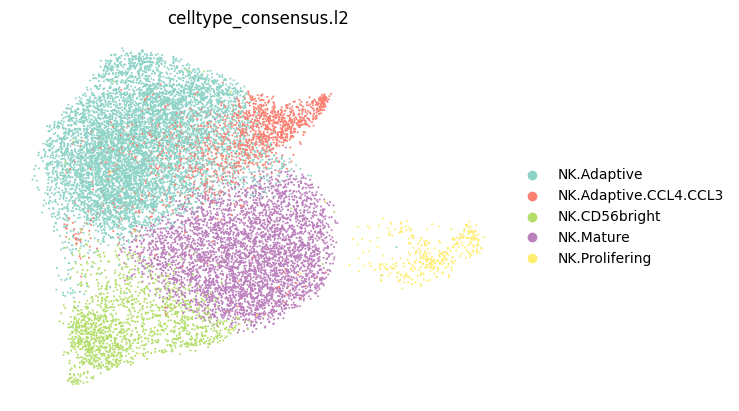

(14519, 23130)

In [29]:
NK = adata[adata.obs["celltype_consensus.l1"] == "NK"].copy()
sc.pl.umap(
    NK,
    color=["celltype_consensus.l2"],
    frameon=False,
    ncols=1,
    palette = 'Set3',
  )


NK.shape


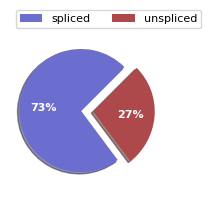

In [30]:
np.amax(NK.layers["counts"])
scv.pl.proportions(NK)


In [31]:
import warnings

warnings.simplefilter("ignore", category=UserWarning)
warnings.simplefilter("ignore", category=FutureWarning)
warnings.simplefilter("ignore", category=DeprecationWarning)

In [32]:
NK.X = NK.layers["counts"].copy()
scv.pp.filter_and_normalize(NK, min_shared_counts=20, n_top_genes=2000)
sc.pp.neighbors(adata, n_pcs=30, n_neighbors=30)
scv.pp.moments(adata, n_pcs=None, n_neighbors=None)
#scv.tl.recover_dynamics(NK, n_jobs=40)



Filtered out 17106 genes that are detected 20 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
         Falling back to preprocessing with `sc.pp.pca` and default params.


2023-02-01 15:09:43.083512: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /apps/eb/2020b/ivybridge/software/Arrow/6.0.0-foss-2021b/lib:/apps/eb/2020b/ivybridge/software/Boost/1.77.0-GCC-11.2.0/lib:/apps/eb/2020b/ivybridge/software/R/4.1.2-foss-2021b/lib/R/lib:/apps/eb/2020b/ivybridge/software/libgit2/1.1.1-GCCcore-11.2.0/lib:/apps/eb/2020b/ivybridge/software/MPFR/4.1.0-GCCcore-11.2.0/lib:/apps/eb/2020b/ivybridge/software/GDAL/3.3.2-foss-2021b/lib:/apps/eb/2020b/ivybridge/software/HDF/4.2.15-GCCcore-11.2.0/lib:/apps/eb/2020b/ivybridge/software/libtirpc/1.3.2-GCCcore-11.2.0/lib:/apps/eb/2020b/ivybridge/software/SciPy-bundle/2021.10-foss-2021b/lib/python3.9/site-packages/numpy/core/lib:/apps/eb/2020b/ivybridge/software/libgeotiff/1.7.0-GCCcore-11.2.0/lib:/apps/eb/2020b/ivybridge/software/PROJ/8.1.0-GCCcore-11

Normalized count data: spliced, unspliced.
computing moments based on connectivities
    finished (0:01:24) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [33]:
scv.tl.velocity(NK, mode ='deterministic')
scv.tl.velocity_graph(NK)

computing neighbors
    finished (0:00:03) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:02) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:01) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/40 cores)


  0%|          | 0/14519 [00:00<?, ?cells/s]

    finished (0:00:15) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)


saving figure to file ./figures/scvelo_NK_scvelo.pdf


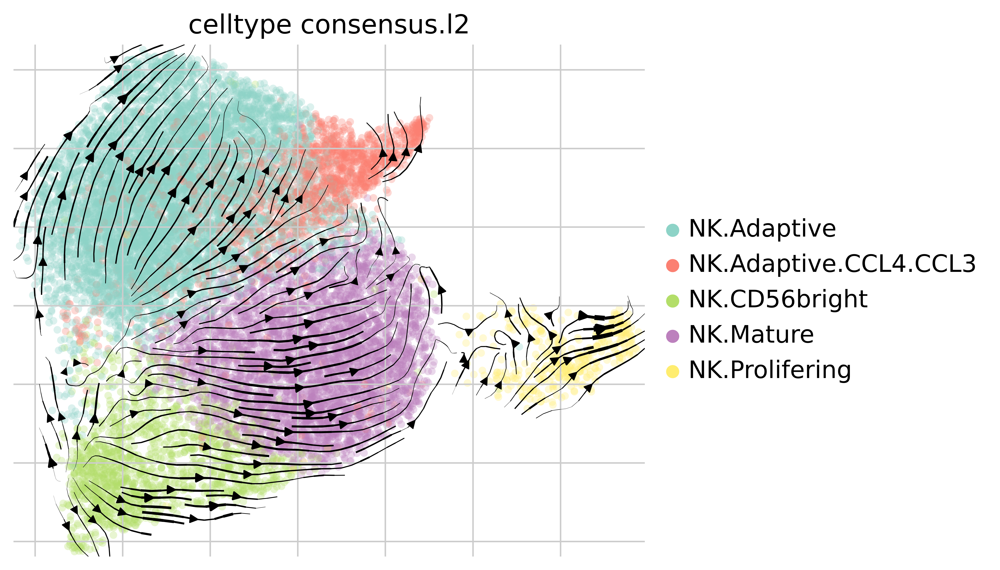

In [201]:
sc.set_figure_params(vector_friendly=True, dpi=500,fontsize=14,dpi_save=1000, figsize = (6,5))
scv.pl.velocity_embedding_stream(NK, 
                                 linewidth=1.5,
                                 basis='umap',
                                 color=["celltype_consensus.l2"],
                                palette = 'Set3',
                                 legend_loc = 'right margin',
                                 save = "NK_scvelo.pdf")


## CellRank

In [100]:
from cellrank.tl.kernels import VelocityKernel
from cellrank.tl.kernels import ConnectivityKernel
from cellrank.tl.estimators import GPCCA
import petsc4py
import slepc4py

In [113]:
# compute initial states and lineage genes
vk = cr.tl.kernels.VelocityKernel(NK, backward=True).compute_transition_matrix()
ck = cr.tl.kernels.ConnectivityKernel(NK, backward=True).compute_transition_matrix()
k = (0.8 * vk + 0.2 * ck).compute_transition_matrix()
g_bwd = cr.tl.estimators.GPCCA(k)
g_bwd.compute_schur(n_components=20, method='krylov')
g_bwd.compute_eigendecomposition()
g_bwd.compute_macrostates(n_states=6, n_cells=50, cluster_key="celltype_consensus.l2")
g_bwd.set_terminal_states_from_macrostates(names = ["NK.CD56bright"])



  0%|          | 0/14519 [00:00<?, ?cell/s]

[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://petsc.org/release/faq/#valgrind and https://petsc.org/release/faq/
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.


  0%|          | 0/14519 [00:00<?, ?cell/s]

[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://petsc.org/release/faq/#valgrind and https://petsc.org/release/faq/
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.


In [114]:
g_bwd.compute_absorption_probabilities(n_jobs=16)
NK.obs['initial_states']
g_bwd.compute_lineage_drivers(lineages="NK.CD56bright", return_drivers=True)
model_initial = cr.ul.models.GAM(NK)    # save for drawing lineage genes of initial states
# It's a right way to run cr.pl.gene_trends() and cr.pl.heatmap() here for lineage genes of initial states,
# but these 2 functions requires latent_time for time_key argument, which can only be recovered after computing terminal states.


  0%|          | 0/1 [00:00<?, ?/s]

[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://petsc.org/release/faq/#valgrind and https://petsc.org/release/faq/
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.


In [124]:
# compute terminal states and lineage genes
vk = cr.tl.kernels.VelocityKernel(NK, backward=False).compute_transition_matrix()
ck = cr.tl.kernels.ConnectivityKernel(NK, backward=False).compute_transition_matrix()
k = (0.8 * vk + 0.2 * ck).compute_transition_matrix()
g_fwd = cr.tl.estimators.GPCCA(k)
g_fwd.compute_schur(n_components=20, method='krylov')
g_fwd.compute_macrostates(n_states=6, n_cells=50, cluster_key="celltype_consensus.l2")
g_fwd.set_terminal_states_from_macrostates(names = ["NK.Mature_1", "NK.Mature_2","NK.Adaptive","NK.Adaptive.CCL4.CCL3"])
g_fwd.compute_absorption_probabilities(n_jobs=16)
NK.obs['terminal_states']
g_fwd.compute_lineage_drivers(lineages=["NK.Mature_1", "NK.Mature_2","NK.Adaptive","NK.Adaptive.CCL4.CCL3"], return_drivers=True)
model_terminal = cr.ul.models.GAM(NK)    # save for drawing lineage genes of terminal states


  0%|          | 0/14519 [00:00<?, ?cell/s]

  0%|          | 0/14519 [00:00<?, ?cell/s]

[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://petsc.org/release/faq/#valgrind and https://petsc.org/release/faq/
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.


  0%|          | 0/4 [00:00<?, ?/s]

[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://petsc.org/release/faq/#valgrind and https://petsc.org/release/faq/
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.


In [125]:
scv.tl.recover_dynamics(NK)
# recover latent time with initial_states_probs and terminal_states_probs
scv.tl.recover_latent_time(NK, vkey='velocity', root_key="initial_states_probs", end_key="terminal_states_probs")


recovering dynamics (using 1/40 cores)


  0%|          | 0/99 [00:00<?, ?gene/s]

[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://petsc.org/release/faq/#valgrind and https://petsc.org/release/faq/
[0]PETSC ERROR: *** Error in `/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/bin/python': free(): invalid pointer: 0x00000000007265e0 ***


    finished (0:02:29) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing latent time using initial_states_probs, terminal_states_probs as prior
    finished (0:00:06) --> added 
    'latent_time', shared time (adata.obs)


In [126]:
scv.tl.paga(
    NK,
    groups="celltype_consensus.l2",
    root_key="initial_states_probs",
    end_key="terminal_states_probs",
    use_time_prior="velocity_pseudotime",
)

running PAGA using priors: ['velocity_pseudotime', 'initial_states_probs', 'terminal_states_probs']
    finished (0:00:04) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


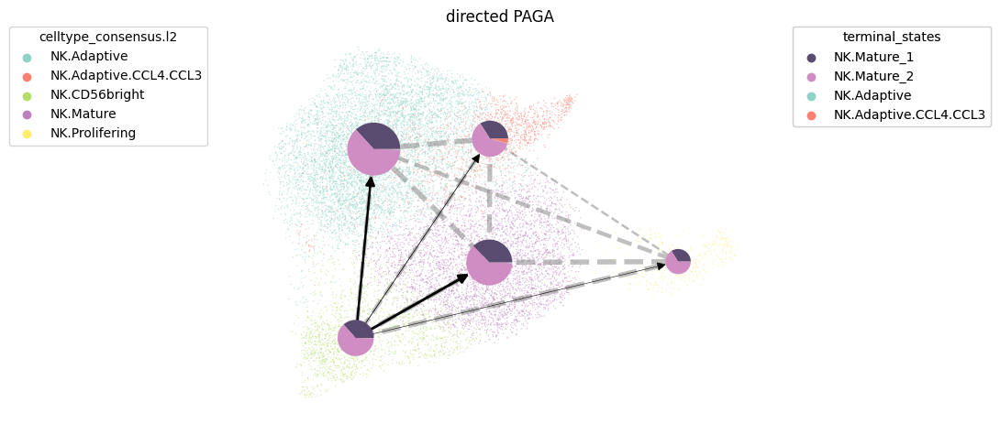

In [127]:
cr.pl.cluster_fates(
    NK,
    mode="paga_pie",
    cluster_key="celltype_consensus.l2",
    basis="umap",
    legend_kwargs={"loc": "top right out"},
    legend_loc="top left out",
    node_size_scale=5,
    edge_width_scale=1,
    max_edge_width=4,
    title="directed PAGA",
)

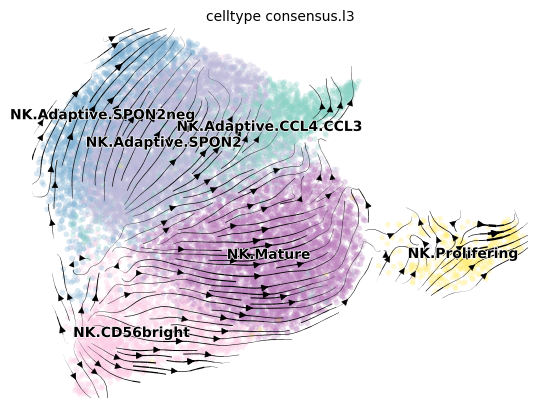

In [107]:
scv.pl.velocity_embedding_stream(NK, 
                                 basis='umap',
                                 color=["celltype_consensus.l3"],
                                palette = 'Set3',
                                )


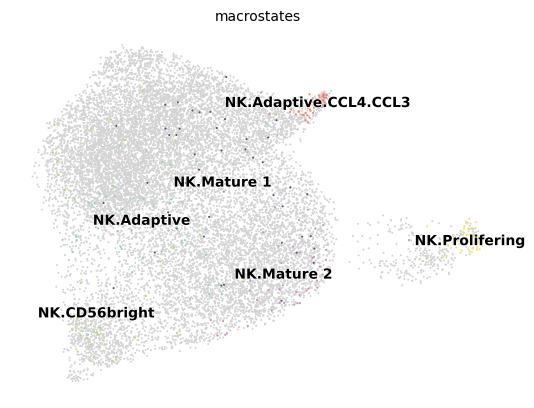

In [144]:
g_fwd.plot_macrostates(discrete=True)


/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()


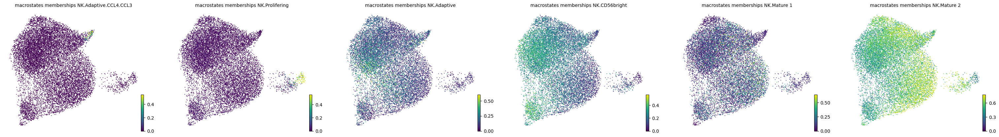

In [145]:
g_fwd.plot_macrostates(same_plot=False)


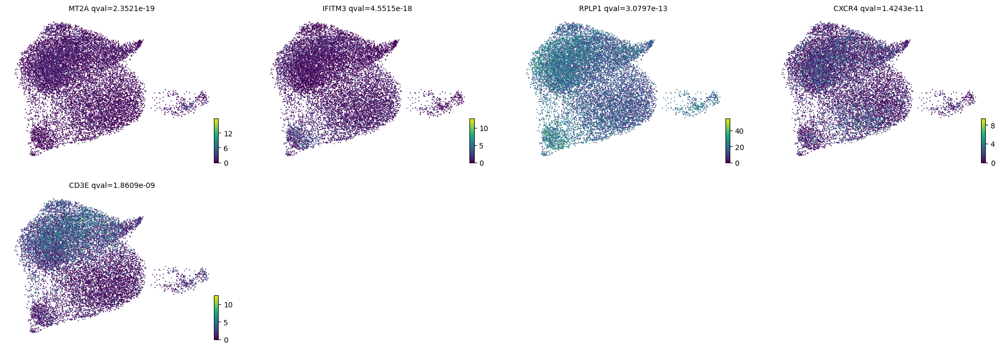

In [148]:
g_fwd.plot_lineage_drivers("NK.Mature_2", n_genes=5)


In [216]:
cr.pl.heatmap(
    NK,
    model_initial,
    genes=NK.varm['terminal_lineage_drivers']["NK.Mature_1_corr"].sort_values(ascending=False).index[:100],
    show_absorption_probabilities=True,
    lineages="NK.Mature_1",
    cluster_key = "celltype_consensus.l2",
    n_jobs=1,
    backend="loky",
)

  0%|          | 0/100 [00:00<?, ?gene/s]

In [217]:
cr.pl.heatmap(
    NK,
    model_initial,
    genes=NK.varm['terminal_lineage_drivers']["NK.Mature_2_corr"].sort_values(ascending=False).index[:100],
    show_absorption_probabilities=True,
    lineages="NK.Mature_2",
    cluster_key = "celltype_consensus.l2",
    n_jobs=1,
    backend="loky",
)

  0%|          | 0/100 [00:00<?, ?gene/s]

In [218]:
cr.pl.heatmap(
    NK,
    model_initial,
    genes=NK.varm['terminal_lineage_drivers']["NK.Adaptive.CCL4.CCL3_corr"].sort_values(ascending=False).index[:100],
    show_absorption_probabilities=True,
    lineages="NK.Mature_2",
    cluster_key = "celltype_consensus.l2",
    n_jobs=1,
    backend="loky",
)

  0%|          | 0/100 [00:00<?, ?gene/s]

In [219]:
cr.pl.heatmap(
    NK,
    model_terminal,
    genes=NK.varm['terminal_lineage_drivers']["NK.Adaptive_corr"].sort_values(ascending=False).index[:100],
    show_absorption_probabilities=True,
    lineages="NK.Adaptive",
    cluster_key = "celltype_consensus.l2",
    n_jobs=1,
    backend="loky",
)

  0%|          | 0/100 [00:00<?, ?gene/s]

6:13186:0]           ib_md.c:1225 UCX  WARN  IB: ibv_fork_init() was disabled or failed, yet a fork() has been issued.
[1675290749.293920] [compg006:13186:0]           ib_md.c:1226 UCX  WARN  IB: data corruption might occur when using registered memory.
[1675291029.751616] [compg006:13186:0]           ib_md.c:1225 UCX  WARN  IB: ibv_fork_init() was disabled or failed, yet a fork() has been issued.
[1675291029.751628] [compg006:13186:0]           ib_md.c:1226 UCX  WARN  IB: data corruption might occur when using registered memory.
[1675291966.946325] [compg006:13186:0]           ib_md.c:1225 UCX  WARN  IB: ibv_fork_init() was disabled or failed, yet a fork() has been issued.
[1675291966.946339] [compg006:13186:0]           ib_md.c:1226 UCX  WARN  IB: data corruption might occur when using registered memory.
[1675725487.462980] [compg006:13186:0]           ib_md.c:1225 UCX  WARN  IB: ibv_fork_init() was disabled or failed, yet a fork() has been issued.
[1675725487.465326] [compg006:13186

Fatal Python error: PyThreadState_Get: the function must be called with the GIL held, but the GIL is released (the current Python thread state is NULL)
Python runtime state: initialized

Current thread 0x00007f3d52535700 (most recent call first):
  File "/apps/eb/2020b/ivybridge/software/Python/3.9.6-GCCcore-11.2.0/lib/python3.9/multiprocessing/connection.py", line 373 in _send
  File "/apps/eb/2020b/ivybridge/software/Python/3.9.6-GCCcore-11.2.0/lib/python3.9/multiprocessing/connection.py", line 416 in _send_bytes
  File "/apps/eb/2020b/ivybridge/software/Python/3.9.6-GCCcore-11.2.0/lib/python3.9/multiprocessing/connection.py", line 211 in send
  File "/apps/eb/2020b/ivybridge/software/Python/3.9.6-GCCcore-11.2.0/lib/python3.9/multiprocessing/managers.py", line 217 in handle_request
  File "/apps/eb/2020b/ivybridge/software/Python/3.9.6-GCCcore-11.2.0/lib/python3.9/threading.py", line 910 in run
  File "/apps/eb/2020b/ivybridge/software/Python/3.9.6-GCCcore-11.2.0/lib/python3.9/thread

  0%|          | 0/4 [00:00<?, ?gene/s]

/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/pygam/utils.py:649: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  bases = (x >= aug_knots[:-1]).astype(np.int) * \
/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/pygam/utils.py:650: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` t

/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/pygam/utils.py:649: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  bases = (x >= aug_knots[:-1]).astype(np.int) * \
/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/pygam/utils.py:650: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` t

/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/pygam/utils.py:649: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  bases = (x >= aug_knots[:-1]).astype(np.int) * \
/gpfs2/well/immune-rep/users/vbw431/python/scvi_new_ivy/lib/python3.9/site-packages/pygam/utils.py:650: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` t

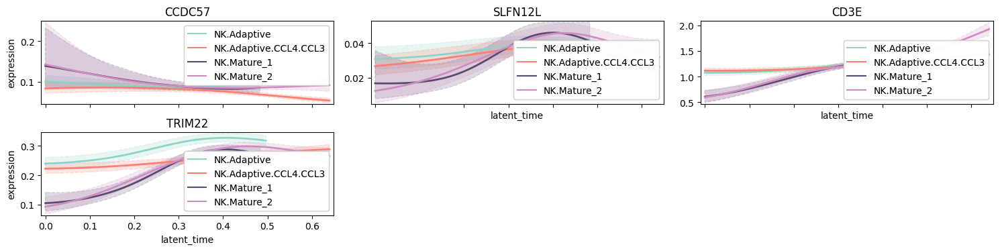

In [149]:
cr.pl.gene_trends(
    NK,
    model=model_terminal,
    data_key="X",
    genes=["CCDC57", "SLFN12L", "CD3E", "TRIM22"],
    ncols=3,
    time_key="latent_time",
    same_plot=True,
    hide_cells=True,
    figsize=(15, 4),
    n_test_points=200,
)

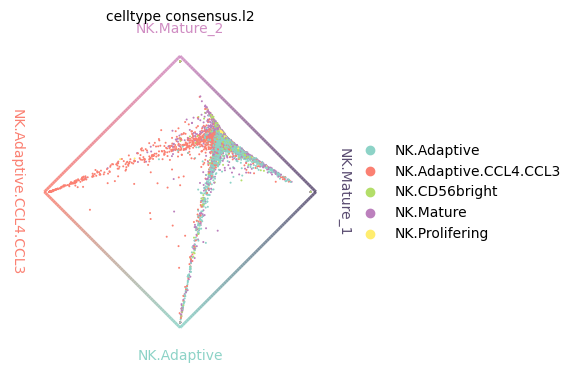

In [150]:
cr.pl.circular_projection(NK, keys="celltype_consensus.l2", legend_loc="right")


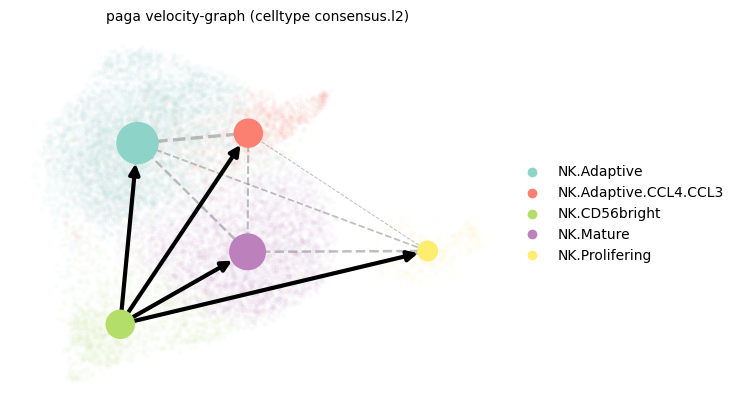

In [161]:
scv.pl.paga(NK, basis='umap', size=50, alpha=.03,
            min_edge_width=3, node_size_scale=2.5)

In [162]:
##perform paga on seperate objects by disease state
study_adatas = {
    "CTRL": NK[NK.obs["study_disease"] == "CTRL"].copy(),
    "HBV": NK[NK.obs["study_disease"] == "HBV"].copy(),
    "HBV_HIV": NK[NK.obs["study_disease"] == "HBV_HIV"].copy()
}


In [164]:
for i in study_adatas:
    scv.tl.paga(study_adatas[i], groups='celltype_consensus.l2')




running PAGA using priors: ['velocity_pseudotime']
    finished (0:00:00) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)
running PAGA using priors: ['velocity_pseudotime']
    finished (0:00:02) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)
running PAGA using priors: ['velocity_pseudotime']
    finished (0:00:01) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


saving figure to file ./figures/scvelo_CTRLPAGA_scvelo.png


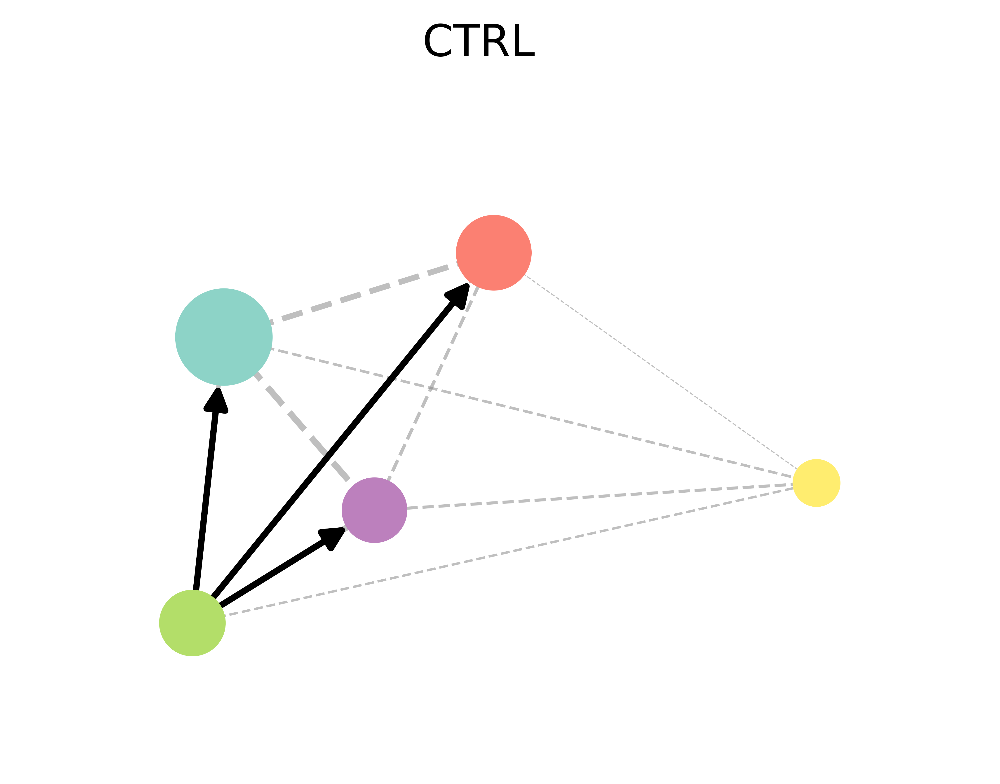

saving figure to file ./figures/scvelo_HBVPAGA_scvelo.png


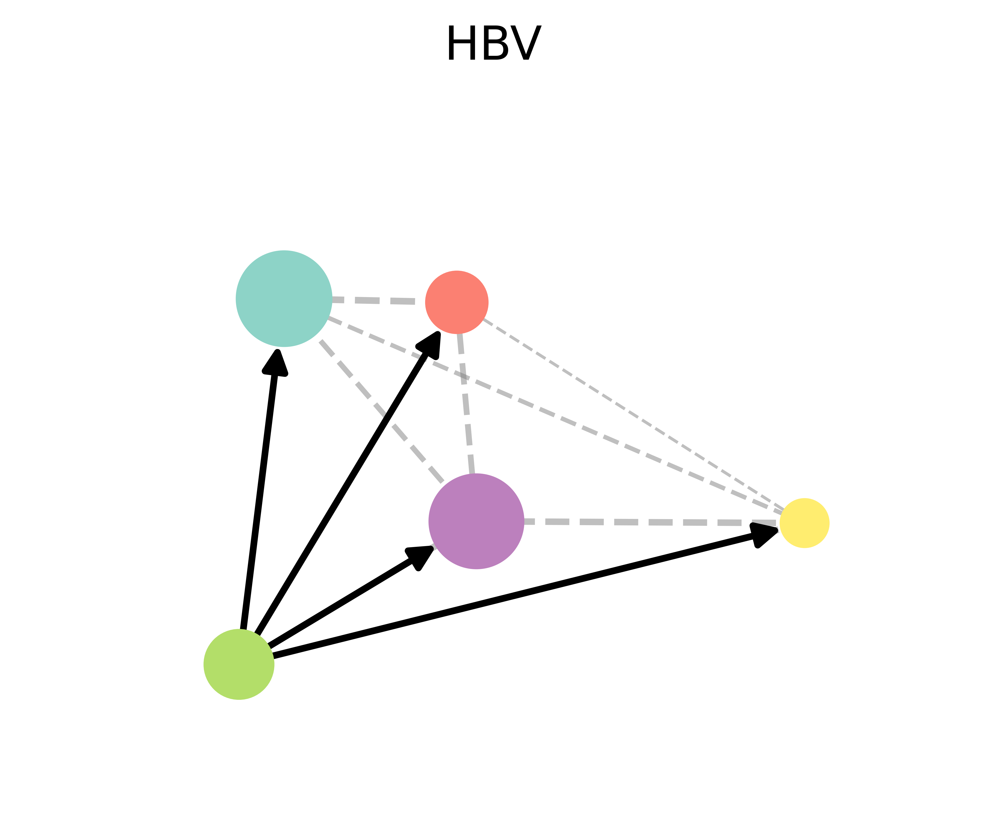

saving figure to file ./figures/scvelo_HBV_HIVPAGA_scvelo.png


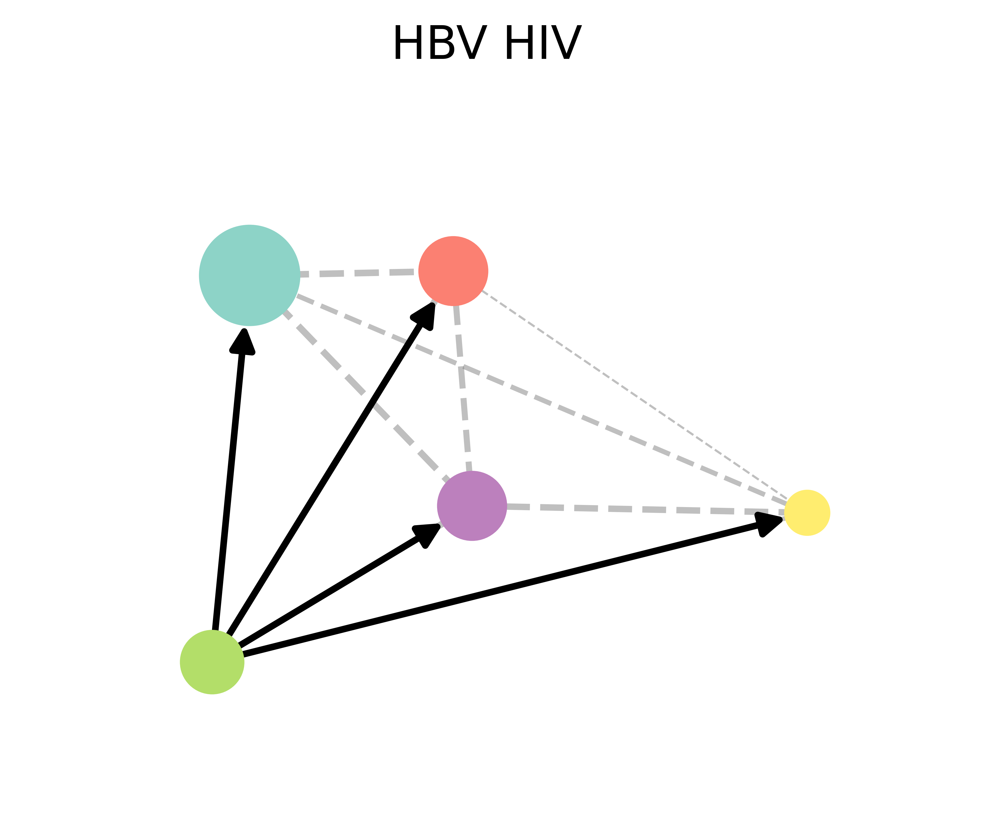

In [204]:
for i in study_adatas:
    scv.pl.paga(study_adatas[i], 
                basis='umap', 
                size=70, 
                alpha=0,
                min_edge_width=2, 
                node_size_scale=2.5,
                title = i,
                legend_loc=None,
               save = i+"PAGA_scvelo.png")